# Importing Packages

In [2]:
import cv2
import numpy as np
import face_recognition
import os
from datetime import datetime
from tensorflow.keras.models import load_model
from time import sleep
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf
import random
from IPython.display import Audio
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['figure.figsize'] = (9.0, 9.0)

# Creating Classes for the Emotions

In [4]:
classes = ["Angry","Happy","Neutral","Sad"]
model = load_model(r'C:\Users\Manasa\Downloads\model\face_emotion.h5')


# Detecting the face in the image and Labeling the Emotion

In [5]:
def emotion_image(model,path,classes):
    img = cv2.imread(path)
    img = cv2.resize(img,(640,640),interpolation=cv2.INTER_AREA)
    facesCurFrame = face_recognition.face_locations(img)
    y1,x2,y2,x1 = facesCurFrame[0]
    cv2.rectangle(img,(x1,y1),(x2,y2),(0,255,0),3)
    roi = img[y1:y2,x1:x2]
    roi = cv2.resize(roi,(48,48),interpolation=cv2.INTER_AREA)

    roi = roi.astype('float')/255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi,axis=0)

    prediction = model.predict(roi)[0]
    label=classes[np.argmax(prediction)]

    label_position = (x1,y1)
    cv2.putText(img,label+str(" Face"),label_position,cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),3)

    plt.imshow(img[:,:,::-1])
    return label

# Based on facial emotion returning the song from the playlist

In [6]:
def get_song(label):
    songs=[]
    music_dir = r'C:\Users\Manasa\Desktop\emotions playlist'
    path = os.path.join(music_dir,label)
    for file in os.listdir(path):
        if file.split(".")[1]=='mp3':
            songs.append(file)
    n = random.randint(0,len(songs)-1)
    target_file = os.path.join(path,songs[n])
    return target_file

#  Input of facial emotions

# NEUTRAL

detected emotion is Neutral
C:\Users\Manasa\Desktop\emotions playlist\Neutral\3.mp3


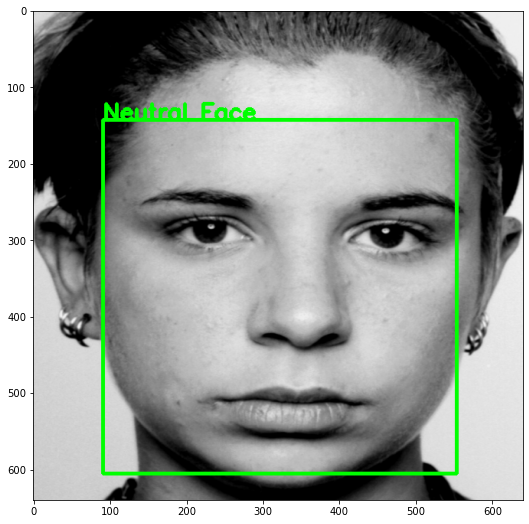

In [5]:
path=r"C:\Users\Manasa\Downloads\neutral.jpg"
label = emotion_image(model,path,classes)
print("detected emotion is {}".format(label))
target_file = get_song(label)
print(target_file)
Audio(data=target_file,autoplay=True)

# SAD

detected emotion is Sad
C:\Users\Manasa\Desktop\emotions playlist\Sad\3.mp3


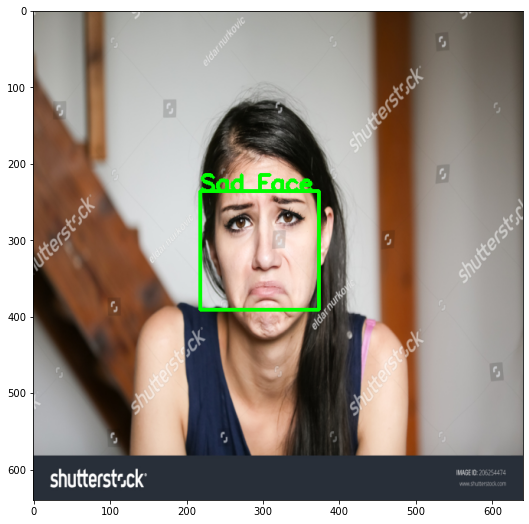

In [6]:
path=r"C:\Users\Manasa\Downloads\sad.jpg"
label = emotion_image(model,path,classes)
print("detected emotion is {}".format(label))
target_file = get_song(label)
print(target_file)
Audio(data=target_file,autoplay=True)

# ANGRY

detected emotion is Angry
C:\Users\Manasa\Desktop\emotions playlist\Angry\4.mp3


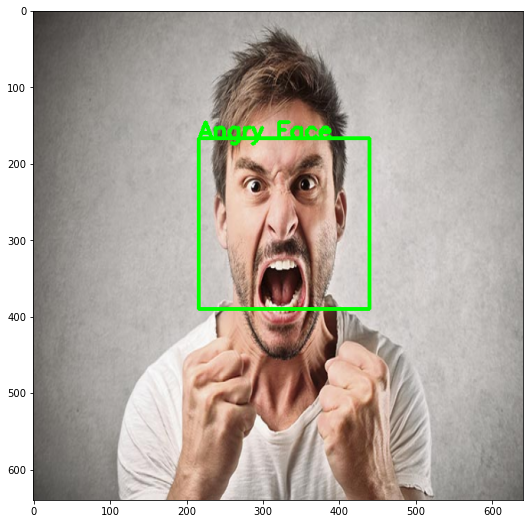

In [7]:
path=r"C:\Users\Manasa\Downloads\angry.jpg"
label = emotion_image(model,path,classes)
print("detected emotion is {}".format(label))
target_file = get_song(label)
print(target_file)
Audio(data=target_file,autoplay=True)

# HAPPY

detected emotion is Happy
C:\Users\Manasa\Desktop\emotions playlist\Happy\4.mp3


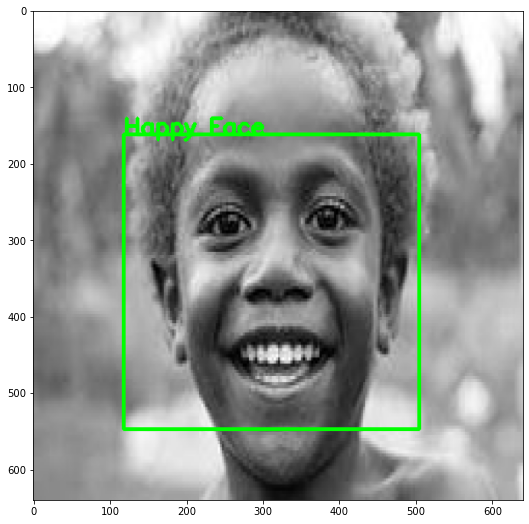

In [8]:
path=r"C:\Users\Manasa\Downloads\happy.jpg"
label = emotion_image(model,path,classes)
print("detected emotion is {}".format(label))
target_file = get_song(label)
print(target_file)
Audio(data=target_file,autoplay=True)

# Detecting facial emotion through webcam

In [7]:
def detect_emotion(k,model,classes):
    #classes = ["Angry","Happy","Neutral","Sad"]
    
    

    counter = 0

    cap = cv2.VideoCapture(0)

    while counter<k:
        success, img = cap.read()
        labels = []
        try :
            facesCurFrame = face_recognition.face_locations(img)
            y1,x2,y2,x1 = facesCurFrame[0]
            cv2.rectangle(img,(x1,y1),(x2,y2),(0,255,0),2)
            roi = img[y1:y2,x1:x2]
            roi = cv2.resize(roi,(48,48),interpolation=cv2.INTER_AREA)
            counter += 1

            if np.sum([roi])!=0:
                roi = roi.astype('float')/255.0
                roi = img_to_array(roi)
                roi = np.expand_dims(roi,axis=0)

                prediction = model.predict(roi)[0]
                label=classes[np.argmax(prediction)]
                print(label)
                labels.append(label)
                label_position = (x1,y1)
                cv2.putText(img,label+str(" Face"),label_position,cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),2)

            else:
                cv2.putText(img,'No Faces',(30,80),cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),2)
            cv2.imshow('Emotion Detector',img)
            if cv2.waitKey(1) & 0xFF == ord('q'):
                cap.release()
                cv2.destroyAllWindows()
                return labels
                break
        except :
            pass
    cap.release()
    cv2.destroyAllWindows()
    return labels

# Printing emotions for each frame and playing songs

In [34]:
labels = detect_emotion(30,model,classes)
print("detected emotion is {}".format(max(labels)))
target_file = get_song(max(labels))
Audio(data=target_file,autoplay=True)

Happy
Happy
Neutral
Neutral
Sad
Happy
Happy
Neutral
Neutral
Neutral
Neutral
Neutral
Neutral
Neutral
Happy
Happy
Neutral
Neutral
Happy
Happy
Neutral
Happy
Neutral
Happy
detected emotion is Happy
